Для анализа возьмём следующую Новостную коллекцию: http://romip.ru/ru/collections/news-collection.html.

Скачаем [news-shevard.xml](https://disk.yandex.ru/d/Fk5oDuCuAyQcTw) - новости за период отставки Шеварднадзе

Документы представлены в таком формате:

```
<document>
   <docID>shevard-1</docID>
   <docURL>d3d3LnJlZ251bS5ydS9leHBuZXdzLzE4NDAyOC5odG1s
</docURL>
   <subject encoding="base64">
z/Dl5PHl5ODy5ev8IMru7Ojy5fLgIMPu8eTz7Psg0O7x8ejoIO/uIOTl6+DsINHNwyDoIPHi/+f/7CDxIPHu7vLl9+Xx8uLl7e3o6uDs6CDv7vHl8ujyIMHz8P/y6P4=
   </subject>
   <agency>cmVnbnVt
</agency>
   <timestamp>
     <date>20031124</date>
     <daytime>46829</daytime>
   </timestamp>
   <content encoding="base64"> MjUg7e7/4fD/IOIgwfPw//Lo6CDh8+Tz8iDi8fLw5ffg8vwg7/Dl5PHl5ODy5ev/IMru7Ojy5fLg
IMPu8eTz7Psg0O7x8ejoIO/uIOTl6+DsINHNwyDoIPHi/+f/7CDxIPHu7vLl9+Xx8uLl7e3o6uDs
6CDA7eTw5f8gyu7q7vjo7eAuCs7tIO/r4O3o8PPl8iDi8fLw5fLo8vzx/yDxIPDg4e736OzoINPr
4O0t0+T97fHq7uPuIOvu6u7s7vLo4u7i4OPu7e7w5ezu7fLt7uPuIOfg4u7k4Cwg7+7h++Lg8vwg
7eAg7+7j8ODt6Pft+/Ug5+Dx8uDi4PUg4iDK//Xy6O3x6u7sIPDg6e7t5S4K0uDq5uUg4iDv6+Dt
4PUgwO3k8OX/IMru6u746O3gIC0g4vHy8OX36CDxIObo8uXr/+zoIMzz9e7w+Ojh6PDx6u7j7iDw
4Onu7eAuCsrg6iDx7u7h+ejr6CDBw9LQyiDiIOHz8P/y8eru7CDw5ePo7u3g6/zt7uwg7vLk5evl
7ejoICLM7uvu5OXm7e7j7iDl5Ojt8fLi4CIsIMDt5PDl/yDK7uru+Ojt4CDm5PPyIO3gIO7k7e7s
IOjnIO/z7ery7uIsIOPk5SD98uAg7vDj4O3o5+D26P8g4eXx7+vg8u3uIPDg8e/w7vHy8ODt/+Xy
IO3g8Oru8uXx8vsg4iDw4Ozq4PUg7/Du4/Dg7Oz7IOHu8Pzh+yDxIO3g8Oru7ODt6OXpLgo=
</content>
</document>
```

Теперь извлечём информацию из всех документов 

In [97]:
import xml.etree.ElementTree as ET
import base64

def parse_xml(file_path):
    # Список для хранения содержимого всех документов
    documents = []

    # Парсинг XML файла
    tree = ET.parse(file_path)
    root = tree.getroot()

    # Пространство имен для поиска элементов
    namespaces = {'ns': 'http://www.romip.ru/data/common'}

    # Находим все элементы <document> в XML
    for doc in root.findall('ns:document', namespaces):
        document_content = {}

        # Извлекаем и декодируем содержимое каждого элемента внутри <document>
        docID = doc.find('ns:docID', namespaces)
        if docID is not None:
            document_content['docID'] = docID.text

        docURL = doc.find('ns:docURL', namespaces)
        if docURL is not None:
            docURL_encoded = docURL.text.strip()
            docURL_decoded = base64.b64decode(docURL_encoded).decode('windows-1251')
            document_content['docURL'] = docURL_decoded

        subject = doc.find('ns:subject', namespaces)
        if subject is not None:
            subject_encoded = subject.text.strip()
            subject_decoded = base64.b64decode(subject_encoded).decode('windows-1251')
            document_content['subject'] = subject_decoded

        agency = doc.find('ns:agency', namespaces)
        if agency is not None:
            agency_encoded = agency.text.strip()
            agency_decoded = base64.b64decode(agency_encoded).decode('windows-1251')
            document_content['agency'] = agency_decoded

        content = doc.find('ns:content', namespaces)
        if content is not None:
            content_encoded = content.text.strip()
            content_decoded = base64.b64decode(content_encoded).decode('windows-1251')
            document_content['content'] = content_decoded

        # Добавляем словарь с данными документа в список
        documents.append(document_content)

    return documents

# Путь к файлу XML
file_path = 'news-shevard.xml'

# Извлечение документов
documents = parse_xml(file_path)

# Вывод результатов
for doc in documents:
    print(doc)

{'docID': 'shevard-1', 'docURL': 'www.regnum.ru/expnews/184028.html', 'subject': 'Председатель Комитета Госдумы России по делам СНГ и связям с соотечественниками посетит Бурятию', 'agency': 'regnum', 'content': '25 ноября в Бурятии будут встречать председателя Комитета Госдумы России по делам СНГ и связям с соотечественниками Андрея Кокошина.\nОн планирует встретиться с рабочими Улан-Удэнского локомотивовагоноремонтного завода, побывать на пограничных заставах в Кяхтинском районе.\nТакже в планах Андрея Кокошина - встречи с жителями Мухоршибирского района.\nКак сообщили БГТРК в бурятском региональном отделении "Молодежного единства", Андрея Кокошина ждут на одном из пунктов, где эта организация бесплатно распространяет наркотесты в рамках программы борьбы с наркоманией.\n'}
{'docID': 'shevard-10', 'docURL': 'www.regnum.ru/expnews/184038.html', 'subject': '50% продавцов Казани не имеют спецодежды', 'agency': 'regnum', 'content': 'В каких условиях трудятся продавцы казанских минимаркетов

In [98]:
# Количество документов в коллекции
print(len(documents))

9791


## Приступим к анализу


In [133]:
# Для теста также создадим тестовую коллекцию
test_documents = [
    {
        'subject': 'Задача со звездочкой: как компании сегодня обновляют парк компьютерной техники',
        'content': 'По экспертным оценкам, пик закупок компьютерной техники в корпоративном сегменте пришелся на 2020 год, когда компании переводили сотрудников на удаленный формат работы.'
    },
    {
        'subject': 'Как компании сегодня обновляют парк компьютерной техники',
        'content': 'Согласно экспертам, в 2020 году произошел пик закупок компьютерной техники в корпоративном сегменте из-за перехода компаний на удаленный формат работы.'
    },
    {
        'subject': 'Обновление парка компьютерной техники в современных компаниях: методы и вызовы',
        'content': 'По мнению специалистов, пик закупок компьютерной техники в корпоративном сегменте пришелся на 2020 год из-за перехода компаний на удаленный формат работы.'
    },
    {
        'subject': 'Заголовок 4',
        'content': 'На Московской бирже формируется новый класс инвесторов — сверхсостоятельные россияне, чьи деньги по тем или иным причинам оказались заперты в России.'
    },
    {
        'subject': 'Заголовок 5',
        'content': 'На бирже в Москве формируется новый класс инвесторов — сверхсостоятельные россияне, чьи деньги по тем или иным причинам оказались заперты в России.'
    },
    {
        'subject': 'Заголовок 6',
        'content': 'На Московской бирже наблюдается появление нового класса инвесторов - сверхсостоятельных россиян, чьи деньги по тем или иным причинам оказались заперты в России.'
    },
    {
        'subject': 'Заголовок 7',
        'content': 'блалблабла'
    },
    {
        'subject': 'Заголовок 8',
        'content': 'МГТУ имени Н. Э. Баумана'
    }
]

In [100]:
%pip install natasha

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


Используя библиотеку Natasha напишем функцию канонизации текста

Канонизация включает в себя очистку текста от "мусора":
* предлогов
* союзов
* знаков препинания

Также в канонизацию входит лемматизация.

In [101]:
from natasha import (
    Segmenter,
    MorphVocab,
    
    NewsEmbedding,
    NewsMorphTagger,
    NewsNERTagger,

    Doc
)

segmenter = Segmenter()
morph_vocab = MorphVocab()
emb = NewsEmbedding()
morph_tagger = NewsMorphTagger(emb)
ner_tagger = NewsNERTagger(emb)


def canonicalize_text(text):
    doc = Doc(text)
    doc.segment(segmenter)
    doc.tag_morph(morph_tagger)

    cleaned_tokens = list(token for token in doc.tokens if token.pos not in {"ADP", "PUNCT", "CCONJ", "SCONJ"})
    for token in cleaned_tokens:
        token.lemmatize(morph_vocab)

    lemmas = list(token.lemma for token in cleaned_tokens)

    return lemmas

In [135]:
from collections import Counter

def generate_title_for_cluster(cluster_docs, keywords_number=2):
    # Собираем все тексты в один длинный текст для анализа
    cluster_text = " ".join(document['subject'] + ' ' + document['content'] for document in cluster_docs)

    # Создаем документ Natasha
    doc = Doc(cluster_text)

    # Разбиваем текст на предложения и токены, выполняем морфологический и NER анализ
    doc.segment(segmenter)
    doc.tag_morph(morph_tagger)
    doc.tag_ner(ner_tagger)

    for token in doc.tokens:
        token.lemmatize(morph_vocab)

    # Извлекаем и лемматизируем ключевые слова: существительные, глаголы, прилагательные
    keywords = [
        _.lemma for _ in doc.tokens
        if _.pos in {'NOUN', 'VERB', 'ADJ'} and _.lemma
    ]

    # Подсчитываем частоту ключевых слов
    keywords_freq = Counter(keywords)

    # Выбираем топ N ключевых слов
    top_keywords = sorted(keywords_freq, key=keywords_freq.get, reverse=True)[:keywords_number]

    # Формируем название из самых частых ключевых слов
    return " ".join(top_keywords)

In [136]:
# Функция для извлечения шинглов
def extract_shingles(words, shingle_size):
    return [' '.join(words[i:i+shingle_size]) for i in range(len(words) - shingle_size + 1)]

In [117]:
%pip install fuzzywuzzy
%pip install python-Levenshtein

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [137]:
# Функция для вычисления сходства между шинглами и возврат показателей их сходства
from fuzzywuzzy import fuzz # type: ignore
import itertools

def get_shingle_similarities(set1, set2):
    shingle_similarities = []
    for s1, s2 in itertools.product(set1, set2):   # итерация по всем комбинациям шинглов из двух наборов
        similarity = fuzz.token_sort_ratio(s1, s2) # cлова в шинглах сравниваются друг с другом, независимо от регистра или порядка
        shingle_similarities.append((s1, s2, similarity))
    return shingle_similarities

In [139]:
# Подготовка данных для кластеризации
connections = {}

SHINGLE_SIZE = 5  # размер шингла

analyzed_documents = test_documents

# Для каждого документа извлечем шинглы его содержимого
all_shingles = [extract_shingles(canonicalize_text(document['subject'] + ' ' + document['content']), SHINGLE_SIZE) 
                for document in analyzed_documents if 'content' in document]

# Порог сходства документов, после которого они считаются дубликатами
SIMILARITY_THRESHOLD = 45

total_similarities = []
duplicate_found = False

# Сравниваем шинглы каждой пары документов и считаем среднее сходство этой пары
for i, shingles1 in enumerate(all_shingles):
    for j, shingles2 in enumerate(all_shingles):
        if i < j:
            similarities = get_shingle_similarities(shingles1, shingles2)
            if similarities:
                average_similarity = sum(sim[2] for sim in similarities) / len(similarities)  # считаем среднее сходство этой пары 
                total_similarities.append(average_similarity)
                connections[(i, j)] = round(average_similarity, 2)
                if average_similarity >= SIMILARITY_THRESHOLD:  # если среднее сходство больше или равно порогового, то 
                    duplicate_found = True                      # значит, что дубликат найден

# Вычисление и вывод общего среднего сходства
if total_similarities:
    overall_average_similarity = sum(total_similarities) / len(total_similarities)
    print(f"Среднее сходство между документами: {round(overall_average_similarity, 2)}%")
else:
    print("Сходства между документами не найдены.")

# Вывод информации о наличии нечётких дубликатов
print("Найдены нечёткие дубликаты" if duplicate_found else "Нечёткие дубликаты не найдены.")

Среднее сходство между документами: 36.24%
Найдены нечёткие дубликаты


In [140]:
# Создаём класс связанного списка, чтобы сгруппировать документы в кластеры
class UnionFind:
    def __init__(self):
        self.parent = {}
    
    def find(self, item):
        if item not in self.parent:
            self.parent[item] = item
        if self.parent[item] != item:
            self.parent[item] = self.find(self.parent[item])
        return self.parent[item]
    
    def union(self, item1, item2):
        root1 = self.find(item1)
        root2 = self.find(item2)
        if root1 != root2:
            self.parent[root1] = root2

# Функция, которая создаёт кластеры
def create_clusters(similarities, threshold):
    uf = UnionFind()
    for (doc1, doc2), similarity in similarities.items():
        if similarity >= threshold:
            uf.union(doc1, doc2)
    
    clusters = {}
    for doc in uf.parent:
        root = uf.find(doc)
        if root not in clusters:
            clusters[root] = []
        clusters[root].append(doc)
    return list(clusters.values())

In [128]:
%pip install networkx

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


Кластер "компания компьютерный техника": [0, 1, 2]
Кластер "заголовок биржа новый": [3, 4, 5]


/tmp/ipykernel_7563/1224542650.py:31: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('jet', len(document_clusters) + 1)  # +1 для некластеризованных документов
/tmp/ipykernel_7563/1224542650.py:58: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


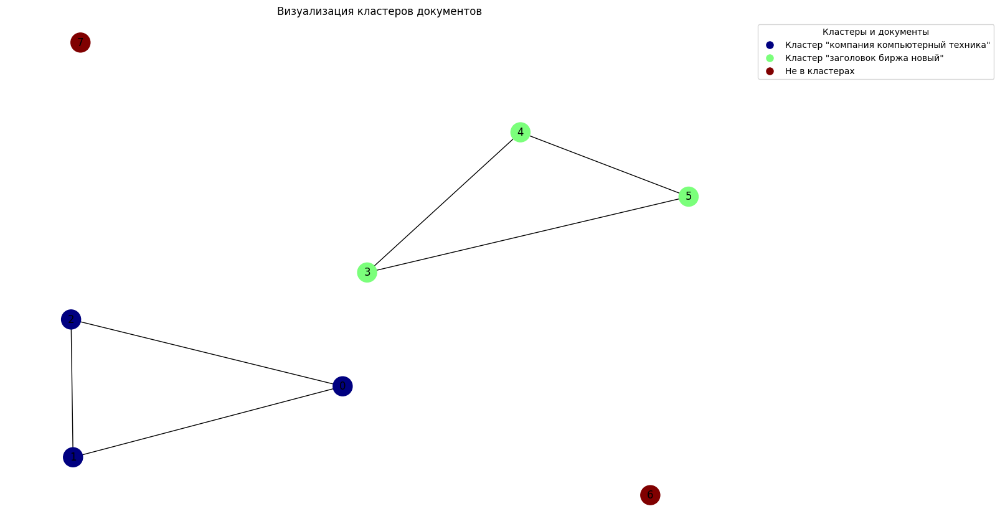

In [147]:
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np

# Создание графа
G = nx.Graph()

# Подготовка данных для графа
cluster_titles = []
non_clustered_docs = set(range(len(analyzed_documents)))  # Набор всех индексов документов

# Группируем документы в кластеры
document_clusters = create_clusters(connections, SIMILARITY_THRESHOLD)

for cluster_index, cluster in enumerate(document_clusters):
    cluster_docs = [analyzed_documents[i] for i in cluster]
    cluster_title = generate_title_for_cluster(cluster_docs, 3)
    cluster_titles.append(cluster_title)
    print(f'Кластер "{cluster_title}": {cluster}')
    for i in cluster:
        non_clustered_docs.discard(i)  # Удалить кластеризованные документы из набора
        for j in cluster:
            if i < j:
                G.add_edge(i, j)  # Добавить ребро для документов в кластерах

# Добавление всех документов в граф
for doc_id in range(len(analyzed_documents)):
    G.add_node(doc_id)  # Убедимся, что каждый документ добавлен как узел

# Назначение цвета каждому кластеру и некластеризованным документам
color_map = plt.cm.get_cmap('jet', len(document_clusters) + 1)  # +1 для некластеризованных документов
colors = []
for doc_id in range(len(analyzed_documents)):
    if doc_id in non_clustered_docs:
        colors.append(color_map(len(document_clusters)))  # Цвет для некластеризованных документов
    else:
        for cluster_index, cluster in enumerate(document_clusters):
            if doc_id in cluster:
                colors.append(color_map(cluster_index))
                break

# Выбор позиций для узлов
pos = nx.spring_layout(G, iterations=10)

# Визуализация графа
plt.figure(figsize=(12, 8))
nx.draw(G, pos, node_color=colors, with_labels=True, cmap=color_map, node_size=500)

# Добавление пользовательской легенды
cluster_patches = [plt.Line2D([0], [0], marker='o', color='w', label=f'Кластер "{name}"',
                              markerfacecolor=color_map(i), markersize=10)
                   for i, name in enumerate(cluster_titles)]
non_cluster_patch = plt.Line2D([0], [0], marker='o', color='w', label='Не в кластерах',
                               markerfacecolor=color_map(len(document_clusters)), markersize=10)
plt.legend(handles=cluster_patches + [non_cluster_patch], title="Кластеры и документы", bbox_to_anchor=(1, 1), loc='upper left')

plt.title('Визуализация кластеров документов')
plt.tight_layout()
plt.show()
